In [1]:
%matplotlib inline

# general
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sys

# Geographical analysis
import geopandas as gpf #libspatialindex nees to be installed first
import json # library to handle JSON files
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
import shapefile as shp
import datetime
from statsmodels.tsa.seasonal import seasonal_decompose
import requests
import descartes

# accessibility analysis
import time
from pandana.loaders import osm
from pandana.loaders import pandash5

# modelling
from sklearn.preprocessing import StandardScaler, MinMaxScaler 
from sklearn.model_selection import train_test_split, cross_val_score 
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
from sklearn import metrics
import xgboost as xgb
from xgboost import plot_importance
from sklearn.metrics import explained_variance_score, mean_squared_error, r2_score

#Hide warnings
import warnings
warnings.filterwarnings('ignore')

# Set plot preference
plt.style.use(style='ggplot')
plt.rcParams['figure.figsize'] = (10, 6)

print('Libraries imported.')

Libraries imported.


### Exploratory Data Analysis

#### Time Series

O tempo é um fator importante a considerar em um modelo quando desejamos prever preços ou tendências. Uma série temporal é simplesmente uma série de pontos de dados ordenados no tempo. Em uma série temporal, o tempo é muitas vezes a variável independente e o objetivo é geralmente fazer uma previsão do futuro. Há também outras questões que vêm para jogar quando lidam com a Série do Tempo. Por exemplo: Existe alguma * sazonalidade * para o preço? É * estacionário *? Mesmo que possamos não ser capazes de incluir este aspecto em nosso modelo, é bom explorá-lo para estar ciente disso e ser capaz de fazer recomendações para pesquisas futuras. Assim, nesta seção, exploraremos esse aspecto dos dados.

Para os preços do Airbnb, um alto nível de sazonalidade é esperado devido às características do mercado. Em fevereiro, durante o carnaval, o preço do aluguel de quartos aumenta consideravelmente. É um evento extremamente popular e grande parte da propriedade alugada disponível terá sido retomada devido ao número de pessoas que atendem a cada ano. Rio tem muitos outros eventos ao longo do ano, concentrados principalmente entre periodos de férias. Para o resto do ano, Rio é uma cidade turistica muito visita por diversas pessoas do mundo.

In [2]:
# Read dataset
df = pd.read_csv('../data/listings_cleaned.csv', index_col=0)

In [3]:
df['host_since'] = pd.to_datetime(df['host_since'])
df['first_review'] = pd.to_datetime(df['first_review'])

In [4]:
print(f"Dos hosts do Airbnb que ainda estão listados no site, o primeiro se inscreveu em {min(df.host_since).strftime('%d %B %Y')}, e o mais recente juntou-se em {max(df.host_since).strftime('%d %B %Y')}.")


Dos hosts do Airbnb que ainda estão listados no site, o primeiro se inscreveu em 13 October 2008, e o mais recente juntou-se em 19 February 2021.


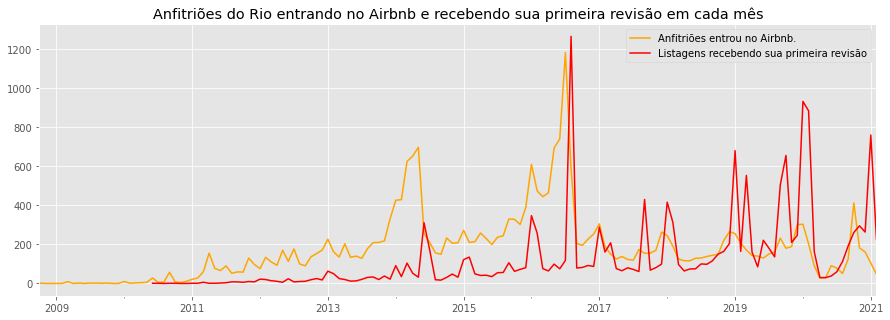

In [5]:
plt.figure(figsize=(15,5))
df.set_index('host_since').resample('MS').size().plot(label='Anfitriões entrou no Airbnb.', color='orange')
df.set_index('first_review').resample('MS').size().plot(label='Listagens recebendo sua primeira revisão', color='red')
plt.title('Anfitriões do Rio entrando no Airbnb e recebendo sua primeira revisão em cada mês')
plt.legend()
plt.xlim('2008-10-13', '2021-02-19') # Limiting to whole months
plt.xlabel('')
plt.ylabel('')
plt.show()

In [6]:
# Creating dataframes for time series analysis
ts_host_since = pd.DataFrame(df.set_index('host_since').resample('MS').size())
ts_first_review = pd.DataFrame(df.set_index('first_review').resample('MS').size())

# Renaming columns
ts_host_since = ts_host_since.rename(columns={0: 'hosts'})
ts_host_since.index.rename('month', inplace=True)
ts_first_review = ts_first_review.rename(columns={0: 'reviews'})
ts_first_review.index.rename('month', inplace=True)

In [7]:
def decompose_time_series(df, title=''):
    """
    Plots the original time series and its decomposition into trend, seasonal and residual.
    """
    # Decomposing the time series
    decomposition = seasonal_decompose(df)
    
    # Getting the trend, seasonality and noise
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    
    # Plotting the original time series and the decomposition
    plt.figure(figsize=(12,8))
    plt.suptitle(title, fontsize=14, y=1)
    plt.subplots_adjust(top=0.80)
    plt.subplot(411)
    plt.plot(df, label='Original')
    plt.legend(loc='upper left')
    plt.subplot(412)
    plt.plot(trend, label='Trend')
    plt.legend(loc='upper left')
    plt.subplot(413)
    plt.plot(seasonal,label='Seasonality')
    plt.legend(loc='upper left')
    plt.subplot(414)
    plt.plot(residual, label='Residuals')
    plt.legend(loc='upper left')
    plt.tight_layout()

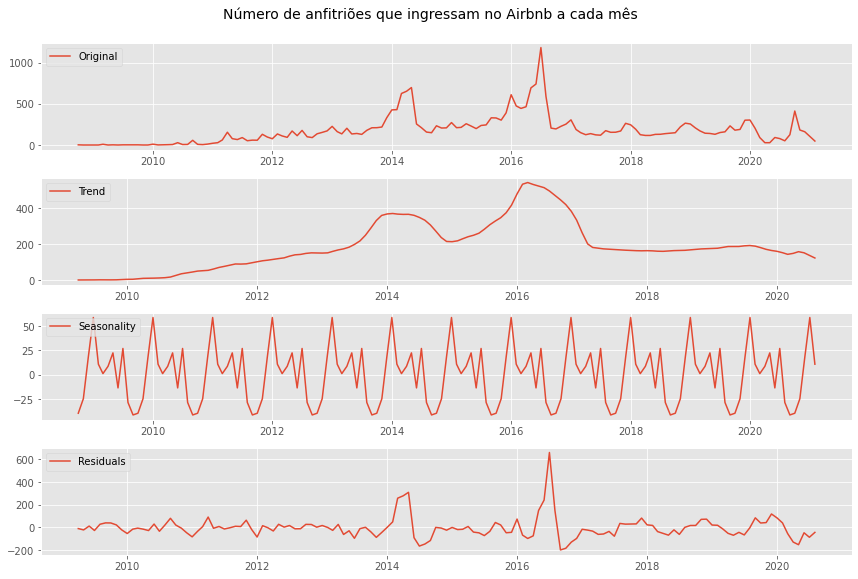

In [8]:
decompose_time_series(ts_host_since, title='Número de anfitriões que ingressam no Airbnb a cada mês')

Como visto acima, há duas sazonalidades. Todos os anos, são vistos dois picos em relação aos hosts se juntando no inicio do ano e ao meio do ano. Outra sazonalidades que valem ser destacadas são os dois picos menores repetidos logo após o inicio do ano e após o meio do ano. Há um grande pico no número de hosts juntando no Airbnb entre 2014 e 2017. Na verdade, houve um rápido crescimento da Airbnb desde o meio de 2015.

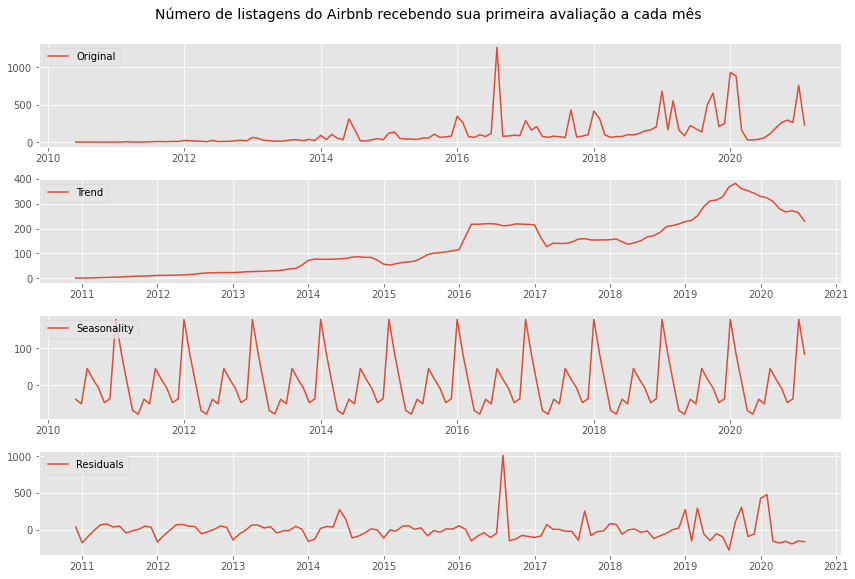

In [9]:
decompose_time_series(ts_first_review, title='Número de listagens do Airbnb recebendo sua primeira avaliação a cada mês')

Outro padrão importante a ser observado é o número de listagens por proprietário / host. Existem várias empresas de gerenciamento profissional do Airbnb que hospedam um grande número de anúncios em um único perfil de host. No entanto, não há tendência de aumento consistente no número médio de propriedades gerenciadas por cada host.

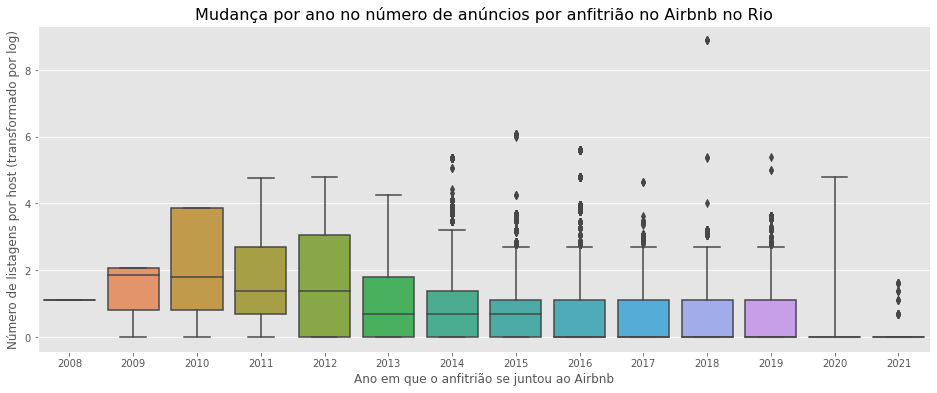

In [10]:
plt.figure(figsize=(16,6))
sns.boxplot(df.host_since.dt.year, np.log(df.host_listings_count))
plt.xlabel('Ano em que o anfitrião se juntou ao Airbnb', fontsize=12)
plt.ylabel('Número de listagens por host (transformado por log)', fontsize=12)
plt.title('Mudança por ano no número de anúncios por anfitrião no Airbnb no Rio', fontsize=16)
plt.show()

Aqui pode-se ver o impacto do COVID19 no ano de 2020, diminuindo drasticamente a quantidade de listagens. 

In [11]:
print("Número médio de anúncios por anfitrião por ano no Airbnb no Rio:")
print(round(df.set_index('host_since').host_listings_count.resample('YS').mean(),2))

Número médio de anúncios por anfitrião por ano no Airbnb no Rio:
host_since
2008-01-01     3.00
2009-01-01     5.28
2010-01-01    18.84
2011-01-01    16.88
2012-01-01    18.11
2013-01-01     7.95
2014-01-01     8.18
2015-01-01     5.18
2016-01-01    12.93
2017-01-01     3.42
2018-01-01    17.83
2019-01-01     3.44
2020-01-01     3.10
2021-01-01     1.03
Freq: AS-JAN, Name: host_listings_count, dtype: float64


In [12]:
# List of the largest host_listings_count and the year the host joined Airbnb
df.sort_values('host_listings_count').drop_duplicates('host_listings_count',keep='last').tail(10)[['host_since', 'host_listings_count']]

,host_since,host_listings_count
id,,
43860154,2019-12-20,151.0
47174070,2014-11-20,158.0
39746798,2014-10-21,214.0
46241088,2018-10-11,215.0
42507971,2019-06-07,222.0
46254050,2018-01-09,223.0
18691400,2016-08-24,275.0
21614301,2015-04-25,396.0
48023744,2015-04-26,436.0


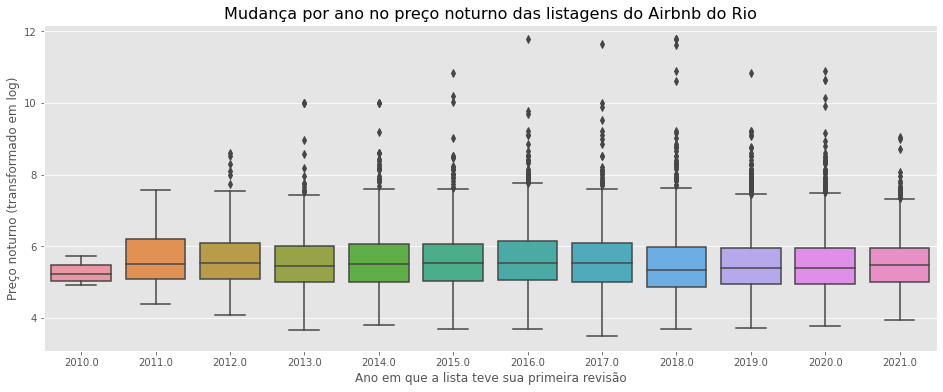

In [13]:
plt.figure(figsize=(16,6))
sns.boxplot(df.first_review.dt.year, np.log(df.price))
plt.xlabel('Ano em que a lista teve sua primeira revisão', fontsize=12)
plt.ylabel('Preço noturno (transformado em log)', fontsize=12)
plt.title('Mudança por ano no preço noturno das listagens do Airbnb do Rio', fontsize=16)
plt.show()

In [14]:
print("Preço médio noturno de anúncios em cada ano no Airbnb do Rio:")
print(round(df.set_index('first_review').price.resample('YS').mean(),2))

Preço médio noturno de anúncios em cada ano no Airbnb do Rio:
first_review
2010-01-01    205.75
2011-01-01    408.62
2012-01-01    466.05
2013-01-01    579.06
2014-01-01    489.68
2015-01-01    526.90
2016-01-01    482.39
2017-01-01    481.59
2018-01-01    700.55
2019-01-01    365.14
2020-01-01    398.92
2021-01-01    366.77
Name: price, dtype: float64


In [15]:
print("Preço médio noturno de anúncios em cada ano no Airbnb no Rio:")
print(round(df.set_index('first_review').price.resample('YS').median(),2))

Preço médio noturno de anúncios em cada ano no Airbnb no Rio:
first_review
2010-01-01    190.5
2011-01-01    244.5
2012-01-01    250.0
2013-01-01    230.0
2014-01-01    249.0
2015-01-01    250.0
2016-01-01    252.0
2017-01-01    250.0
2018-01-01    210.0
2019-01-01    220.0
2020-01-01    218.0
2021-01-01    240.0
Name: price, dtype: float64


In [16]:
# Dropping host_since and first_review as they are no longer needed
df.drop(['host_since', 'first_review'], axis=1, inplace=True)

Em termos de mudanças nos preços ao longo do tempo, o preço médio por noite para listagens do Airbnb no Rio aumentou ligeiramente nos últimos 10 anos. Em particular, o limite superior dos preços dos imóveis aumentou, resultando em um aumento maior no preço médio em comparação com a mediana. O preço médio em 2010 foi de 205 e a mediana de 190, enquanto o preço médio em 2020(último ano completo de dados) foi de 398 e a mediana de 218.

#### Numerical Features

In [17]:
df.describe()

,host_is_superhost,host_listings_count,host_has_profile_pic,host_identity_verified,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,...,cooking_basics,white_goods,elevator,gym,parking,host_greeting,hot_tub_sauna_or_pool,internet,long_term_stays,private_entrance
count,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,2.659100e+04,...,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000,26591.000000
mean,0.171223,9.367568,0.996653,0.630514,4.160393,1.661164,2.542364,742.583092,4.725170,3.822496e+04,...,0.390809,0.759618,0.614418,0.175511,0.572036,0.193750,0.278214,0.898800,0.858185,0.196946
std,0.376711,93.121768,0.057757,0.482675,2.494182,1.034040,2.118171,5371.163063,19.110299,6.132427e+06,...,0.487941,0.427324,0.486742,0.380410,0.494793,0.395243,0.448128,0.301599,0.348867,0.397699
min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000e+00,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,1.000000,1.000000,0.000000,2.000000,1.000000,1.000000,157.000000,1.000000,3.000000e+01,...,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000
50%,0.000000,1.000000,1.000000,1.000000,4.000000,1.000000,2.000000,280.000000,2.000000,1.000000e+03,...,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000
75%,0.000000,4.000000,1.000000,1.000000,5.000000,2.000000,3.000000,550.000000,4.000000,1.125000e+03,...,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000
max,1.000000,7218.000000,1.000000,1.000000,16.000000,30.000000,50.000000,625216.000000,1000.000000,1.000000e+09,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


`price`

Olhando para a distribuição de preços, os preços anunciados variam de 0 a 625.216. Os extremos do intervalo são devido aos hosts não entenderem como usar os preços anunciados do Airbnb corretamente. Os preços anunciados podem ser definidos para qualquer valor arbitrário, e esses são os preços que mostram quando as datas não são inseridas no site. Depois de inserir as datas que deseja ocupar o imóvel, os preços podem variar muito.

Infelizmente, esse modelo estará prevendo preços anunciados, em vez dos preços que foram realmente pagos. No entanto, alguma limpeza dos valores particularmente úteis será feita. Valores muito pequenos abaixo de 50 serão aumentados para 50.

Há quedas notáveis nos preços de 500 (primeiro gráfico, linha vermelha), 500 (segundo gráfico, linha verde) e 1.000 (segundo gráfico, linha vermelha). Valores acima de 5.000 serão reduzidos para 5.000.

In [18]:
print(f"Os preços anunciados variam de {min(df.price)} a {max(df.price)}.")

Os preços anunciados variam de 0 a 625216.


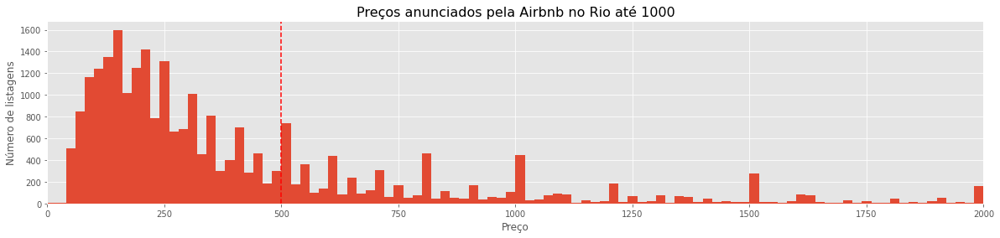

In [19]:
# Distribution of prices from £0 to £1000
plt.figure(figsize=(20,4))
df.price.hist(bins=100, range=(0,2000))
plt.margins(x=0)
plt.axvline(500, color='red', linestyle='--')
plt.title("Preços anunciados pela Airbnb no Rio até 1000", fontsize=16)
plt.xlabel("Preço")
plt.ylabel("Número de listagens")
plt.show()

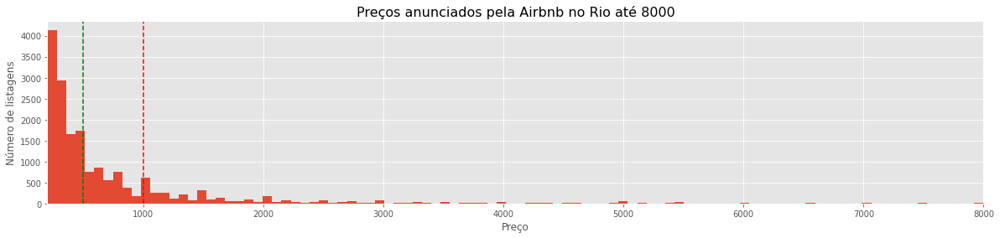

In [20]:
# Distribution of prices from £200 upwards
plt.figure(figsize=(20,4))
df.price.hist(bins=100, range=(200, 8000))
plt.margins(x=0)
plt.axvline(500, color='green', linestyle='--')
plt.axvline(1000, color='red', linestyle='--')
plt.title("Preços anunciados pela Airbnb no Rio até 8000", fontsize=16)
plt.xlabel("Preço")
plt.ylabel("Número de listagens")
plt.show()

In [21]:
# Replacing values under 50 with 50
df.loc[df.price <= 50, 'price'] = 50

# Replacing values over 1000 with 1000
df.loc[df.price >= 5000, 'price'] = 5000

`host_listings_count`

O número mediano de listagens que o host possui é 1. Isso significa que, em média (mediana), cada listagem é hospedada por um host que apenas gerencia essa listagem. A média é maior (9) devido a alguns hosts gerenciarem alguns (muito) listagens, conforme discutido acima na seção Séries Temporais. Por exemplo, o host com o maior número de listagens possui 7218 listagens sob seu ID. Cerca de 39% das listagens são de hosts com uma listagem e a outra metade são de hosts com várias listagens.

Duas dificuldades em discernir quantas listagens os hosts têm em média são:

1) este número é conhecido apenas no nível da listagem, então hosts com mais listagens são representados com mais frequência (por exemplo, um host com 10 listagens pode ser representado até 10 vezes no conjunto de dados)

2) as outras listagens de um host podem não estar no Rio, portanto, alguns hosts com várias listagens podem aparecer várias vezes no conjunto de dados e outros podem aparecer apenas uma vez

In [22]:
print("Número mediano de listagens por host:", int(df.host_listings_count.median()))
print("Número médio de listagens por host:", int(round(df.host_listings_count.mean())))
print("Maior número de listagens por host:", int(round(df.host_listings_count.max())))
print(f"{int(round(100*len(df[df.host_listings_count == 1])/len(df)))}% de listagens são de hosts com uma listagem.")

Número mediano de listagens por host: 1
Número médio de listagens por host: 9
Maior número de listagens por host: 7218
39% de listagens são de hosts com uma listagem.


`accommodates`, `bathrooms`, `bedrooms` and `beds`

A configuração de propriedade mais comum acomoda duas ou três pessoas em uma cama em um quarto, com um banheiro. Não é novidade que as propriedades que acomodam mais pessoas alcançam taxas notavelmente mais altas por noite, com retornos decrescentes chegando a cerca de 10 pessoas.

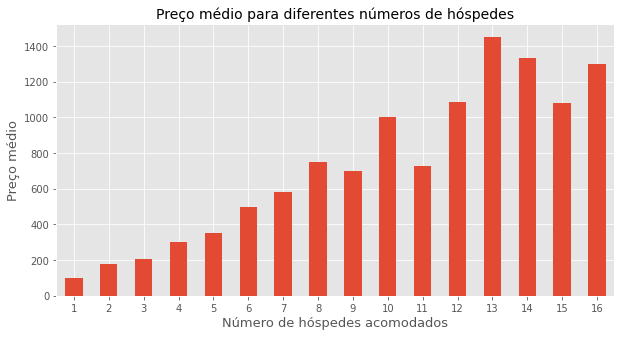

In [23]:
plt.figure(figsize=(10,5))
df.groupby('accommodates').price.median().plot(kind='bar')
plt.title('Preço médio para diferentes números de hóspedes', fontsize=14)
plt.xlabel('Número de hóspedes acomodados', fontsize=13)
plt.ylabel('Preço médio', fontsize=13)
plt.xticks(rotation=0)
plt.xlim(left=0.5)
plt.show()

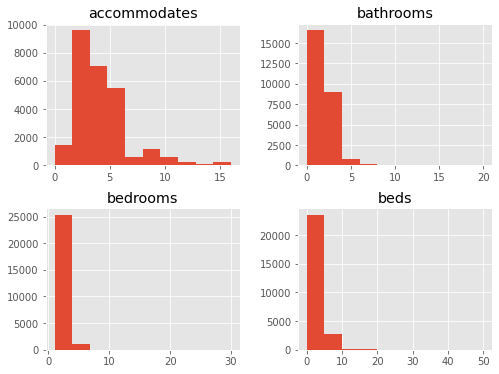

In [24]:
df[['accommodates', 'bathrooms', 'bedrooms', 'beds']].hist(figsize=(8,6));

#### Categorical Features

`Neighbourhood`

Muitas das listagens do Airbnb estão centralizadas em Copacabana, o que é consistente com a grande atração da região, especialmente durante férias e eventos.

In [30]:
# Renaming the neighbourhood column
df.rename(columns={'neighbourhood_cleansed': 'borough'}, inplace=True)

# Importing the Edinburgh borough boundary GeoJSON file as a dataframe in geopandas
map_df = gpf.read_file(r'../data/neighbourhoods.geojson')
map_df.head()

,neighbourhood,neighbourhood_group,geometry
0,Paquetá,None,"MULTIPOLYGON Z (((-43.10567 -22.74888 0.00000,..."
1,Freguesia (Ilha),None,"MULTIPOLYGON Z (((-43.17170 -22.77661 0.00000,..."
2,Bancários,None,"MULTIPOLYGON Z (((-43.18915 -22.78318 0.00000,..."
3,Galeão,None,"MULTIPOLYGON Z (((-43.22804 -22.78374 0.00000,..."
4,Portuguesa,None,"MULTIPOLYGON Z (((-43.20763 -22.79498 0.00000,..."


In [31]:
# Dropping the empty column
map_df.drop('neighbourhood_group', axis=1, inplace=True)

# Creating a dataframe of listing counts and median price by borough
borough_df = pd.DataFrame(df.groupby('borough').size())
borough_df.rename(columns={0: 'number_of_listings'}, inplace=True)
borough_df['median_price'] = df.groupby('borough').price.median().values

# Joining the dataframes
borough_map_df = map_df.set_index('neighbourhood').join(borough_df)

borough_map_df

,geometry,number_of_listings,median_price
neighbourhood,,,
Paquetá,"MULTIPOLYGON Z (((-43.10567 -22.74888 0.00000,...",34.0,260.0
Freguesia (Ilha),"MULTIPOLYGON Z (((-43.17170 -22.77661 0.00000,...",2.0,754.0
Bancários,"MULTIPOLYGON Z (((-43.18915 -22.78318 0.00000,...",3.0,150.0
Galeão,"MULTIPOLYGON Z (((-43.22804 -22.78374 0.00000,...",3.0,79.0
Portuguesa,"MULTIPOLYGON Z (((-43.20763 -22.79498 0.00000,...",21.0,84.0
...,...,...,...
Barra de Guaratiba,"MULTIPOLYGON Z (((-43.52203 -23.00780 0.00000,...",56.0,310.0
Grumari,"MULTIPOLYGON Z (((-43.50815 -23.03310 0.00000,...",3.0,655.0
Caju,"MULTIPOLYGON Z (((-43.22518 -22.87464 0.00000,...",NaN,NaN


In [32]:
borough_map_df[borough_map_df['number_of_listings'] == borough_map_df['number_of_listings'].max()]

,geometry,number_of_listings,median_price
neighbourhood,,,
Copacabana,"MULTIPOLYGON Z (((-43.17186 -22.95896 0.00000,...",7706.0,250.0


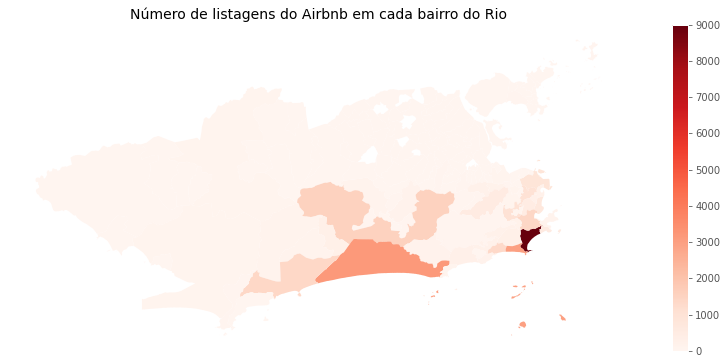

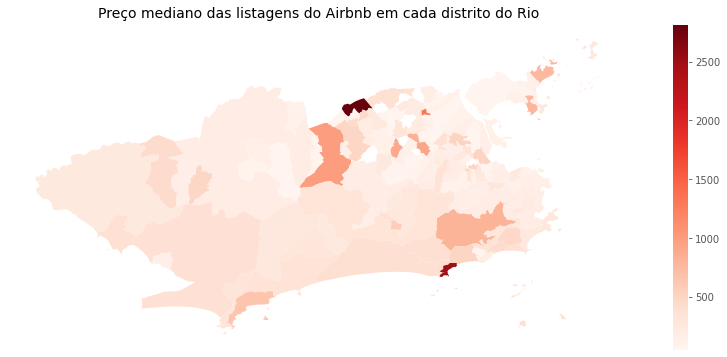

In [28]:
# Plotting the number of listings in each borough
fig1, ax1 = plt.subplots(1, figsize=(15, 6))
borough_map_df.plot(column='number_of_listings', cmap='Reds', ax=ax1)
ax1.axis('off')
ax1.set_title('Número de listagens do Airbnb em cada bairro do Rio', fontsize=14)
sm = plt.cm.ScalarMappable(cmap='Reds', norm=plt.Normalize(vmin=0, vmax=9000), )
sm._A = [] # Creates an empty array for the data range
cbar = fig1.colorbar(sm)
plt.show()

# Plotting the median price of listings in each borough
fig2, ax2 = plt.subplots(1, figsize=(15, 6))
borough_map_df.plot(column='median_price', cmap='Reds', ax=ax2)
ax2.axis('off')
ax2.set_title('Preço mediano das listagens do Airbnb em cada distrito do Rio', fontsize=14)
sm = plt.cm.ScalarMappable(cmap='Reds', norm=plt.Normalize(vmin=min(borough_map_df.median_price), vmax=max(borough_map_df.median_price)))
sm._A = [] # Creates an empty array for the data range
cbar = fig2.colorbar(sm)
plt.show()

`property_type` and `room_type` 

Cerca de 66% das propriedades são apartamentos / flats. O restante são quartos, casas ou tipos de propriedade mais incomuns.

Cerca de 72% das listagens são casas inteiras (ou seja, você está alugando a propriedade inteira por conta própria). A maioria dos restantes são quartos privados (ou seja, você está alugando um quarto e possivelmente também um banheiro, mas haverá outras pessoas na propriedade). Menos de 1% são quartos compartilhados (ou seja, você está compartilhando um quarto com o proprietário do imóvel ou outros hóspedes).

In [33]:
def category_count_plot(col, figsize=(8,4)):
    """
    Plots a simple bar chart of the total count for each category in the column specified.
    A figure size can optionally be specified.
    """
    plt.figure(figsize=figsize)
    df[col].value_counts().plot(kind='bar')
    plt.title(col)
    plt.xticks(rotation=0)
    plt.show()

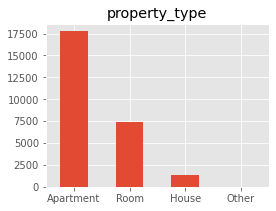

Apartment    0.667181
Room         0.279042
House        0.052800
Other        0.000978
Name: property_type, dtype: float64


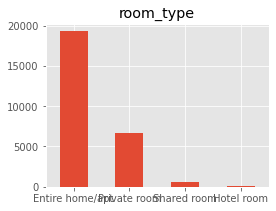

Entire home/apt    0.724493
Private room       0.248806
Shared room        0.022978
Hotel room         0.003723
Name: room_type, dtype: float64


In [34]:
for col in ['property_type', 'room_type']:
    category_count_plot(col, figsize=(4,3))
    print(df[col].value_counts(normalize=True))

`review` categories

Para cada categoria de review, a maioria das listagens que tiveram uma review recebeu uma classificação 10/10 para essa categoria (ou 95-100 / 100 no geral). Avaliações de 8 ou menos são raras. Os hóspedes parecem estar mais otimistas quanto à comunicação, check-ins e precisão.

In [36]:
df['review_scores_rating'].value_counts()

95-100/100    10351
80-94/100      4477
0-79/100       1276
Name: review_scores_rating, dtype: int64

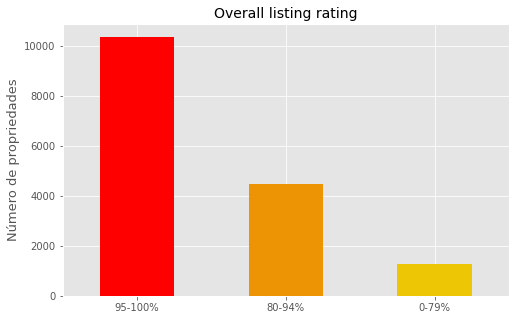

In [37]:
fig, ax = plt.subplots(1, 1, figsize=(8,5))
ax.set_title('Overall listing rating', fontsize=14)
df['review_scores_rating'].value_counts().sort_index(ascending=False).plot(kind='bar', color=['red', '#ed9405', '#edc605', '#ffec19' ], ax=ax)
ax.set_xticklabels(labels=['95-100%', '80-94%', '0-79%'], rotation=0)
ax.set_xlabel('')
ax.set_ylabel('Número de propriedades', fontsize=13)
plt.show()

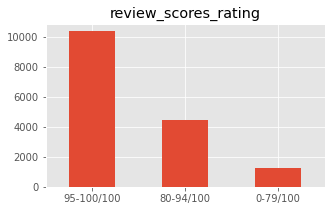

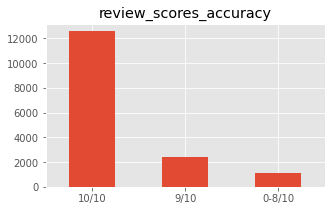

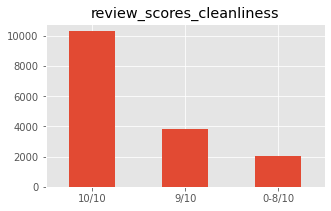

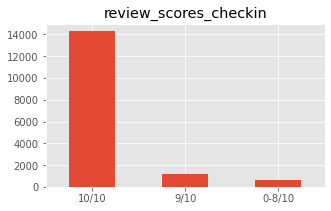

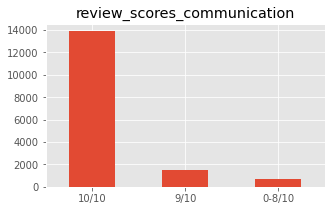

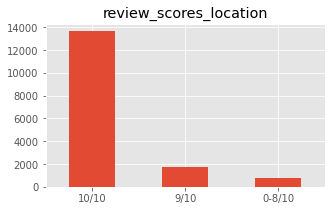

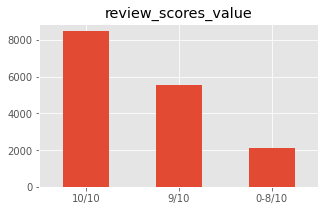

In [38]:
for col in list(df.columns[df.columns.str.startswith("review_scores") == True]):
    category_count_plot(col, figsize=(5,3))

`first_review` and `last_review`

O período de tempo mais comum em que as listagens do Airbnb ativas atualmente tiveram sua primeira revisão é de 2 a 3 anos. Isso significa que muitas listagens no site estão ativas há pelo menos alguns anos. No entanto, relativamente poucos estão ativos há mais de quatro anos.

A categoria mais comum para o tempo desde que uma listagem recebeu sua última revisão é de mais de 1 ano. Isso significa que muitas listagens não foram revisadas recentemente. A maioria deles é provavelmente o que às vezes é chamado de listagens 'inativas', porque embora estejam tecnicamente disponíveis no site, não têm seus calendários abertos e não estão disponíveis para reserva.

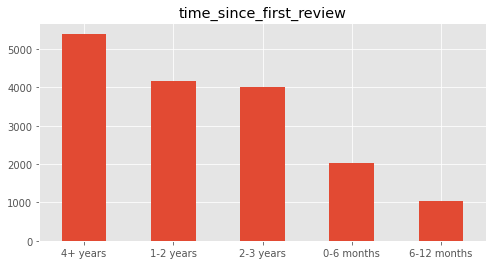

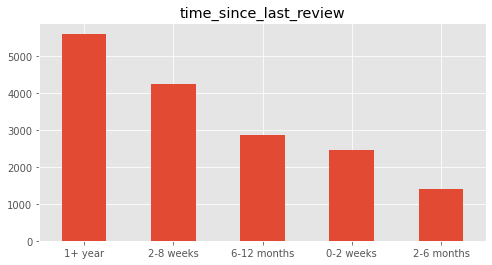

In [39]:
for col in ['time_since_first_review', 'time_since_last_review']:
    category_count_plot(col)

**Venue proximity**

Como parte de nosso modelo, procuramos explorar a proximidade de certos locais como um possível preditor de preços. A facilidade de locomoção e a capacidade de chegar a lugares podem ser um fator decisivo na hora de escolher uma acomodação. A proximidade de certos locais, como principais atrações turísticas, restaurantes, cafés e até lojas podem nos ajudar a prever o preço. Para isso, usaremos a * API do Foursquare * para explorar os locais por bairro. Como discutido antes, Copacabana é a área que concentra a maioria das listagens do Airbnb.

Agora recuperamos a lista de locais com suas localizações. Usaremos a * API do Foursquare * para explorar os locais ao redor das listagens, usando a latitude e longitude de cada bairro. Em seguida, descobriremos quais locais são os mais comuns e selecionaremos os locais mais comuns como pontos de interesse para nossa análise de acessibilidade.

https://docs.mageplaza.com/social-login-m2/how-to-configure-foursquare-api.html

In [48]:
# Define Foursquare Credentials 

CLIENT_ID = 'A12JNXGB1NMWQPBJZTMA3AVSEP3OZOWTTB4YKCOINWSP2PPZ'# your Foursquare ID
CLIENT_SECRET = '1P323TJPLDZBLA5ESM0402X2ODIBC0PKKFDPE2UWHE2OHAX0' # your Foursquare Secret
VERSION = '20210301'
LIMIT = 30
print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: A12JNXGB1NMWQPBJZTMA3AVSEP3OZOWTTB4YKCOINWSP2PPZ
CLIENT_SECRET:1P323TJPLDZBLA5ESM0402X2ODIBC0PKKFDPE2UWHE2OHAX0


In [41]:
map_df.head()

,neighbourhood,geometry
0,Paquetá,"MULTIPOLYGON Z (((-43.10567 -22.74888 0.00000,..."
1,Freguesia (Ilha),"MULTIPOLYGON Z (((-43.17170 -22.77661 0.00000,..."
2,Bancários,"MULTIPOLYGON Z (((-43.18915 -22.78318 0.00000,..."
3,Galeão,"MULTIPOLYGON Z (((-43.22804 -22.78374 0.00000,..."
4,Portuguesa,"MULTIPOLYGON Z (((-43.20763 -22.79498 0.00000,..."


Precisamos da latitude e longitude dos bairros para recuperar os locais por bairro. Podemos acessar isso na coluna `geometry` do nosso DataFrame.

In [42]:
type(map_df.geometry)

geopandas.geoseries.GeoSeries

Da coluna `geometry` no GeoDataFrame, podemos ver que ele retorna um GeoSeries. Para recuperar os locais por bairro, primeiro extraímos a latitude e a longitude ou `x` e` y` do objeto de ponto no GeoSeries. O código a seguir retorna `x` e` y` como colunas GeoDataFrame separadas dentro do `map_df` original.

In [43]:
map_df["longitude"] = map_df.centroid.x
map_df["latitude"] = map_df.centroid.y

In [44]:
map_df.head()

,neighbourhood,geometry,longitude,latitude
0,Paquetá,"MULTIPOLYGON Z (((-43.10567 -22.74888 0.00000,...",-43.111233,-22.764232
1,Freguesia (Ilha),"MULTIPOLYGON Z (((-43.17170 -22.77661 0.00000,...",-43.168732,-22.784674
2,Bancários,"MULTIPOLYGON Z (((-43.18915 -22.78318 0.00000,...",-43.180994,-22.792451
3,Galeão,"MULTIPOLYGON Z (((-43.22804 -22.78374 0.00000,...",-43.236395,-22.807811
4,Portuguesa,"MULTIPOLYGON Z (((-43.20763 -22.79498 0.00000,...",-43.207216,-22.799775


In [45]:
# Function to loop for venues through all neighbourhoods
#url = 'https://api.foursquare.com/v2/venues/search?categoryId=50aa9e094b90af0d42d5de0d,530e33ccbcbc57f1066bbff3,530e33ccbcbc57f1066bbff9,4f2a25ac4b909258e854f55f&intent=browse&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format()
def getNearbyVenues(names, latitudes, longitudes, radius):
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
        
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
        
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
         # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])
        
    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighbourhood', 
                  'Neighbourhood Latitude', 
                  'Neighbourhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

Agora, executamos a função acima em cada bairro e criamos um novo dataframe chamado * edinburgh_venues *.

In [50]:
rio_venues = getNearbyVenues(names=map_df['neighbourhood'],
                                   latitudes=map_df['latitude'],
                                   longitudes=map_df['longitude'],
                                 radius = 500
                                  )

Paquetá
Freguesia (Ilha)
Bancários
Galeão
Portuguesa
Barros Filho
Tauá
Flamengo
Moneró
Campo Grande
Jardim América
Vigário Geral
Cocotá
Jardim Carioca
Pavuna
Parada de Lucas
Cordovil
Jardim Guanabara
Parque Colúmbia
Praia da Bandeira
Pitangueiras
Penha Circular
Bangu
Cacuia
Irajá
Coelho Neto
Anchieta
Acari
Costa Barros
Guadalupe
Brás de Pina
Penha
Zumbi
Ribeira
Parque Anchieta
Vista Alegre
Ricardo de Albuquerque
Colégio
Honório Gurgel
Olaria
Vila da Penha
Maré
Vila Militar
Cidade Universitária
Rocha Miranda
Ramos
Realengo
Vila Kosmos
Marechal Hermes
Vicente de Carvalho
Paciência
Engenho da Rainha
Turiaçú
Complexo do Alemão
Vaz Lobo
Padre Miguel
Bento Ribeiro
Bonsucesso
Inhaúma
Tomás Coelho
Madureira
Osvaldo Cruz
Santa Cruz
Santíssimo
Magalhães Bastos
Senador Camará
Cavalcanti
Campo dos Afonsos
Higienópolis
Abolição
Manguinhos
Engenheiro Leal
Saúde
Pilares
Del Castilho
Jacarezinho
Taquara
Piedade
Cascadura
Vila Valqueire
Maria da Graça
Quintino Bocaiúva
Todos os Santos
Jardim Sulacap
Ca

Verificar o tamanho do dataframe de retorno

In [52]:
print(rio_venues.shape)
rio_venues.head()

(2053, 7)


,Neighbourhood,Neighbourhood Latitude,Neighbourhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Paquetá,-22.764232,-43.111233,Parque Darke de Mattos,-22.767168,-43.111351,Park
1,Paquetá,-22.764232,-43.111233,Hotel Lido,-22.762042,-43.110205,Boarding House
2,Paquetá,-22.764232,-43.111233,Praia dos Tamoios,-22.761351,-43.107832,Beach
3,Paquetá,-22.764232,-43.111233,Praia da Moreninha,-22.764292,-43.107619,Beach
4,Paquetá,-22.764232,-43.111233,Praia José Bonifácio,-22.763198,-43.109968,Beach


In [54]:
#!pwd
# Saving Data set
rio_venues.to_csv(r'../data/Rio_Venues.csv')

In [55]:
# Read dataset
rio_venues = pd.read_csv('../data/Rio_Venues.csv', index_col=0)

Venues returned per neighbourhood

In [56]:
rio_venues.groupby('Neighbourhood').count()

,Neighbourhood Latitude,Neighbourhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighbourhood,,,,,,
Abolição,26,26,26,26,26,26
Acari,5,5,5,5,5,5
Alto da Boa Vista,1,1,1,1,1,1
Anchieta,14,14,14,14,14,14
Andaraí,12,12,12,12,12,12
...,...,...,...,...,...,...
Vila Valqueire,18,18,18,18,18,18
Vila da Penha,30,30,30,30,30,30
Vista Alegre,22,22,22,22,22,22


**Unique categories of venues**

In [60]:
print('Há {} categorias únicas.'.format(len(rio_venues['Venue Category'].unique())))

Há 267 categorias únicas.


**Number of venues per category**

In [61]:
rio_venues.groupby('Venue Category').count()

,Neighbourhood,Neighbourhood Latitude,Neighbourhood Longitude,Venue,Venue Latitude,Venue Longitude
Venue Category,,,,,,
ATM,1,1,1,1,1,1
Acai House,3,3,3,3,3,3
Accessories Store,3,3,3,3,3,3
Adult Boutique,1,1,1,1,1,1
American Restaurant,4,4,4,4,4,4
...,...,...,...,...,...,...
Wine Bar,4,4,4,4,4,4
Wine Shop,2,2,2,2,2,2
Wings Joint,2,2,2,2,2,2


**Analysis per neighbourhood**

In [62]:
# One Hot Encoding
rio_onehot = pd.get_dummies(rio_venues[['Venue Category']], prefix = "", prefix_sep = "")

## Add neighbourhood column back to df
rio_onehot['Neighbourhood'] = rio_venues['Neighbourhood']

# Move neighbourhood column to the first column
fixed_columns = [rio_onehot.columns[-1]] + list(rio_onehot.columns[:-1])
rio_onehot = rio_onehot[fixed_columns]

# display
rio_onehot.head()

,Neighbourhood,ATM,Acai House,Accessories Store,Adult Boutique,American Restaurant,Aquarium,Arcade,Argentinian Restaurant,Art Gallery,...,Vegetarian / Vegan Restaurant,Veterinarian,Video Store,Water Park,Waterfront,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,Paquetá,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Paquetá,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Paquetá,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Paquetá,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Paquetá,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [63]:
# New df dimensions
rio_onehot.shape

(2053, 268)

**Agrupe as linhas por bairro e tomando a média e a frequência de ocorrência de cada categoria**

In [64]:
rio_grouped = rio_onehot.groupby('Neighbourhood').mean().reset_index()
rio_grouped

,Neighbourhood,ATM,Acai House,Accessories Store,Adult Boutique,American Restaurant,Aquarium,Arcade,Argentinian Restaurant,Art Gallery,...,Vegetarian / Vegan Restaurant,Veterinarian,Video Store,Water Park,Waterfront,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,Abolição,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Acari,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Alto da Boa Vista,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Anchieta,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Andaraí,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
152,Vila Valqueire,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
153,Vila da Penha,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
154,Vista Alegre,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
155,Zumbi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


**Coloque cada bairro junto com seus 5 locais mais comuns**

In [65]:
num_top_venues = 5

for hood in rio_grouped['Neighbourhood']:
    print("----"+hood+"----")
    temp = rio_grouped[rio_grouped['Neighbourhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Abolição----
           venue  freq
0      BBQ Joint  0.15
1  Deli / Bodega  0.08
2     Restaurant  0.08
3     Food Truck  0.08
4            Bar  0.04


----Acari----
            venue  freq
0    Soccer Field   0.2
1  Ice Cream Shop   0.2
2          Market   0.2
3    Churrascaria   0.2
4     Pizza Place   0.2


----Alto da Boa Vista----
               venue  freq
0  French Restaurant   1.0
1                ATM   0.0
2        Pet Service   0.0
3       Optical Shop   0.0
4    Organic Grocery   0.0


----Anchieta----
                   venue  freq
0                  Plaza  0.29
1   Gym / Fitness Center  0.14
2  General Entertainment  0.07
3                 Church  0.07
4   Fast Food Restaurant  0.07


----Andaraí----
              venue  freq
0            Bakery  0.25
1        Restaurant  0.17
2  Department Store  0.08
3          Mountain  0.08
4  Botanical Garden  0.08


----Anil----
                 venue  freq
0          Pizza Place  0.14
1       Farmers Market  0.07
2  Fried Chick

**Coloque isso no dataframe do pandas**

In [66]:
# Function to sort venues in descending order
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [67]:
import numpy as np

# New dataframe ordered
indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighbourhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighbourhoods_venues_sorted = pd.DataFrame(columns=columns)
neighbourhoods_venues_sorted['Neighbourhood'] = rio_grouped['Neighbourhood']

for ind in np.arange(rio_grouped.shape[0]):
    neighbourhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(rio_grouped.iloc[ind, :], 
                                                                          num_top_venues)

neighbourhoods_venues_sorted.head()

,Neighbourhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Abolição,BBQ Joint,Restaurant,Food Truck,Deli / Bodega,Bakery
1,Acari,Ice Cream Shop,Churrascaria,Pizza Place,Market,Soccer Field
2,Alto da Boa Vista,French Restaurant,Yoga Studio,Farm,Frame Store,Fountain
3,Anchieta,Plaza,Gym / Fitness Center,Food Truck,Supermarket,Fast Food Restaurant
4,Andaraí,Bakery,Restaurant,Botanical Garden,Plaza,Department Store


**Vejamos quantas categorias estão no primeiro local mais comum.**

In [68]:
print('Há {} categorias únicas.'.format(len(neighbourhoods_venues_sorted['1st Most Common Venue'].unique())))

Há 67 categorias únicas.


In [72]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
neighbourhoods_venues_sorted.groupby('1st Most Common Venue').count()

,Neighbourhood,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
1st Most Common Venue,,,,,
Acai House,1,1,1,1,1
Art Gallery,1,1,1,1,1
Athletics & Sports,2,2,2,2,2
Auto Workshop,1,1,1,1,1
BBQ Joint,3,3,3,3,3
Bakery,11,11,11,11,11
Bar,15,15,15,15,15
Beach,1,1,1,1,1
Boat or Ferry,2,2,2,2,2


De cima, observamos que os locais mais comuns no conjunto de dados são Bar, Restaurant, Burger Joint, Bakery, Gyn, Pizza, Food Truck. É claro que diferentes restaurantes estão em subcategorias, o que os torna menos comuns do que se fossem agregados. Assim, para fins de contabilização dos locais que podem ter o maior impacto no preço, limitaremos os locais às categorias mais comuns. É improvável que ter um hotel próximo afete o preço, já que as listagens do Airbnb são consideradas em uma categoria diferente de aluguel de curto prazo, devido aos diferentes benefícios que oferecem em relação aos hotéis. Assim, essa categoria de locais não será considerada.

### 4. Walkability to nearest venues

Usaremos essas informações sobre locais para selecionar pontos de interesse para os quais iremos representar graficamente e medir o acesso a cada um. Para isso, usaremos [OSMnx] (https://geoffboeing.com/2016/11/osmnx-python-street-networks/) e [Pandana] (https://udst.github.io/pandana/introduction bibliotecas .html # Contributor-to-pandana).

Pandana é uma biblioteca gráfica útil que permite que os quadros de dados do Pandas sejam passados para um gráfico de rede que mapeia análises em nível de gráfico para operações C subjacentes. Tudo isso quer dizer que é muito mais rápido do que os gráficos tradicionais baseados em Python, como o NetworkX.

Em certas situações, como o desempenho de análises de acessibilidade, isso torna o desempenho in-memory e o desenvolvimento iterativo com base nesta biblioteca possível, ao contrário do que seria um processo de desenvolvimento complicado com ferramentas que falham em alavancar o mesmo grau de nível C utilização de operações.

#### Points of interest (POIs) and network data from OSM
Agora temos os pontos de interesse. Para nosso caso, já temos o POIS recuperado usando a API do Foursquare. Como descobrimos na seção anterior, Pubs, Restaurantes, Cafés e Supermercados / Mercearias são nosso POIS.

In [73]:
# same with Edinburghvenues
rio_venues['Venue Category'].value_counts()


Brazilian Restaurant                        121
Bar                                          99
Bakery                                       92
Plaza                                        72
Pizza Place                                  66
Burger Joint                                 66
Gym / Fitness Center                         63
Gym                                          62
Restaurant                                   56
Snack Place                                  46
Food Truck                                   33
Sandwich Place                               32
Japanese Restaurant                          31
Fast Food Restaurant                         29
Ice Cream Shop                               28
Pharmacy                                     27
Athletics & Sports                           25
Music Venue                                  22
Italian Restaurant                           20
Supermarket                                  20
Train Station                           

In [74]:
#Get just Bar, Restaurant, Burger Joint, Bakery, Gyn, Pizza
start_time = time.time()

# Points of interest already exists. Load from rio_venues
df_pois = rio_venues.copy()
terms = ['Bar', 'Restaurant', 'Burger Joint', 'Bakery', 'Gyn', 'Pizza']
df_pois = df_pois[df_pois['Venue Category'].str.contains('|'.join(terms))]
df_pois.to_csv(r'../data/foursquare_amenities.csv', index=id, header=True)
method = 'loaded from CSV'

print('{:,} POIs {} in {:,.2f} seconds'.format(len(df_pois), method, time.time()-start_time))
df_pois.head()

711 POIs loaded from CSV in 0.01 seconds


,Neighbourhood,Neighbourhood Latitude,Neighbourhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
5,Paquetá,-22.764232,-43.111233,Quintal da Regina,-22.760820,-43.108288,Bar
6,Paquetá,-22.764232,-43.111233,Tia Leleta Bar,-22.760765,-43.108334,Brazilian Restaurant
8,Paquetá,-22.764232,-43.111233,Zeca's Restaurante,-22.761253,-43.107708,Brazilian Restaurant
22,Bancários,-22.792451,-43.180994,Bar Água Viva,-22.795046,-43.180115,Burger Joint
24,Bancários,-22.792451,-43.180994,Rei do Bolinho de Bacalhau,-22.795611,-43.183378,Seafood Restaurant


In [75]:
# Making sure each variable's type makes sense
df_pois.dtypes

Neighbourhood               object
Neighbourhood Latitude     float64
Neighbourhood Longitude    float64
Venue                       object
Venue Latitude             float64
Venue Longitude            float64
Venue Category              object
dtype: object

In [76]:
# how many points of interest of each type of amenity did we retrieve?
df_pois['Venue Category'].value_counts()

Brazilian Restaurant                 121
Bar                                   99
Bakery                                92
Burger Joint                          66
Pizza Place                           66
Restaurant                            56
Japanese Restaurant                   31
Fast Food Restaurant                  29
Italian Restaurant                    20
Dive Bar                              17
Seafood Restaurant                    14
Sushi Restaurant                       8
Sports Bar                             7
Mexican Restaurant                     6
Asian Restaurant                       6
Beer Bar                               6
Juice Bar                              6
Northeastern Brazilian Restaurant      5
Comfort Food Restaurant                5
Vegetarian / Vegan Restaurant          5
Wine Bar                               4
Middle Eastern Restaurant              4
American Restaurant                    4
Portuguese Restaurant                  3
German Restauran

Os restaurantes são divididos em subcategorias. Vamos apenas colocá-los juntos.

In [77]:
# Put all restaurant, bar and pub venues together under same name
df_pois.loc[df_pois['Venue Category'].str.contains('Restaurant', case=False), 'Venue Category'] = 'Restaurant'
df_pois.loc[df_pois['Venue Category'].str.contains('Bar', case=False), 'Venue Category'] = 'Bar'
df_pois.loc[df_pois['Venue Category'].str.contains('Pub', case=False), 'Venue Category'] = 'Pub'
df_pois['Venue Category'].value_counts()

Restaurant      338
Bar             149
Bakery           92
Burger Joint     66
Pizza Place      66
Name: Venue Category, dtype: int64

Em seguida, obtemos os dados da rede de ruas da API OSM.

In [96]:
# configure filenames to save/load network datasets

# Edinburgh's bounding box found here: https://boundingbox.klokantech.com/
# a cordenada de latitude e longitude esta invertida
bbox = [-23.076309, -43.756757,-22.854101, -43.176519] 
bbox_string = '_'.join([str(x) for x in bbox])
net_filename = 'data/network_{}.h5'.format(bbox_string)

In [97]:
type(G)

NameError: name 'G' is not defined

In [99]:
start_time = time.time()

# query the OSM API for the street network within the specified bounding box
network = osm.pdna_network_from_bbox(bbox[0], bbox[1], bbox[2], bbox[3])
method = 'downloaded from OSM'

Requesting network data within bounding box from Overpass API in 1 request(s)
Posting to http://www.overpass-api.de/api/interpreter with timeout=180, "{'data': '[out:json][timeout:180];(way["highway"]["highway"!~"motor|proposed|construction|abandoned|platform|raceway"]["foot"!~"no"]["pedestrians"!~"no"](-23.07630900,-43.75675700,-22.85410100,-43.17651900);>;);out;'}"
Downloaded 43,743.2KB from www.overpass-api.de in 200.79 seconds
Server remark: "runtime error: Query timed out in "print" at line 1 after 192 seconds."
Downloaded OSM network data within bounding box from Overpass API in 1 request(s) and 202.69 seconds
Returning OSM data with 321,978 nodes and 58,373 ways...
Edge node pairs completed. Took 64.84 seconds
Returning processed graph with 75,550 nodes and 106,313 edges...
Completed OSM data download and Pandana node and edge table creation in 271.70 seconds


In [100]:
print(type(network))

<class 'pandana.network.Network'>


In [103]:
# identify nodes that are connected to fewer than some threshold of other nodes within a given distance
lcn = network.low_connectivity_nodes(impedance=1000, count=10, imp_name='distance')

# remove low-connectivity nodes and save to h5
network.save_hdf5('../data/mynetwork.h5',rm_nodes=lcn)

In [102]:
print('Network with {:,} nodes {} in {:,.2f} secs'.format(len(network.node_ids), method, time.time()-start_time))

Network with 75,550 nodes downloaded from OSM in 323.01 secs


Ao salvar uma rede em HDF5, é possível excluir certos nós. Isso pode ser útil ao refinar uma rede para que inclua apenas nós validados. Como exemplo, você pode usar o método `low_connectivity_nodes ()` para identificar os nós que podem não estar conectados à rede maior e, em seguida, excluir esses nós ao salvar em HDF5. No design atual do Pandana, não é possível modificar uma rede no local. Em vez disso, salve a rede (com os nós de baixa conectividade removidos) em HDF5 e carregue-o desse arquivo reiniciando o notebook.

#### Calculate accessibility to any amenity we retrieved

É aqui que a realização de análises geográficas em Python mostra seu poder, em oposição a sentar-se diante de um pacote GIS. Pandana foi construído para ser rápido. Primeiro, passaremos por uma distância máxima de pesquisa. Isso permite uma etapa chave que acelera pesquisas futuras: o Pandana construirá uma representação condensada da rede (implementada em C ++), permitindo cálculos rápidos dentro de um raio definido de cada nó. Em seguida, construímos uma tabela de distâncias para os 5 pontos de interesse mais próximos a partir de algumas interseções.
Quando terminar, as análises de acessibilidade para diferentes amenidades selecionadas podem ser feitas em menos de um segundo. (Nos bastidores, dois algoritmos tornam isso possível: [hierarquias de contração] (https://www.mjt.me.uk/posts/contraction-hierarchies/) e [kd-trees] (https: //www.geeksforgeeks. org / k-dimensional-tree /).

Esta seção do bloco de notas é fortemente baseada no [bloco de notas de demonstração do Pandana] do professor Geoff Boeing (https://nbviewer.jupyter.org/github/gboeing/urban-data-science/blob/master/20-Accessibility-Walkability/pandana- acessibilidade-demo-full.ipynb).

In [104]:
# configure search at a max distance of 1 km for up to the 10 nearest points-of-interest
distance = 1000
num_pois = 10
num_categories = len(df_pois['Venue']) + 1 #one for each amenity, plus one extra for all of them combined

In [105]:
## precomputes the range queries (the reachable nodes within this maximum distance)
# so, as long as you use a smaller distance, cached results will be used
network.precompute(distance + 1)

In [106]:
# initialize the underlying C++ points-of-interest engine
network.init_pois(num_categories=num_categories, max_dist=distance, max_pois=num_pois)

In [107]:
# initialize a category for all amenities with the locations specified by the lon and lat columns
# with Edinburgh_Venues subset df_pois
network.set_pois(category='all', x_col = df_pois['Venue Longitude'], y_col = df_pois['Venue Latitude'])

Reading parameters from init_pois()
Reading parameters from init_pois()


In [108]:
# searches for the n-nearest amenities (of all types) to each node in the network
all_access = network.nearest_pois(distance=distance, category='all', num_pois=num_pois)

# it returns a df with the number of columns equal to the number of POIs that are requested
# each cell represents the network distance from the node to each of the n POIs
print('{:,} nodes'.format(len(all_access)))
all_access.head() # Distance in meters to ten nearest amenities

75,550 nodes


,1,2,3,4,5,6,7,8,9,10
id,,,,,,,,,,
25038483,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0
25038484,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0
25038485,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0
25038487,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0
25038488,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0,1000.0


#### Produce Accessibility maps

In [109]:
# keyword arguments to pass for the matplotlib figure
bbox_aspect_ratio = (bbox[2] - bbox[0]) / (bbox[3] - bbox[1])
fig_kwargs = {'facecolor':'w', 
              'figsize':(10, 10 * bbox_aspect_ratio)}

# keyword arguments to pass for scatter plots
plot_kwargs = {'s':5, 
               'alpha':0.9, 
               'cmap':'Reds', 
               'edgecolor':'none'}

# network aggregation plots are the same as regular scatter plots, but without a reversed colormap
agg_plot_kwargs = plot_kwargs.copy()
agg_plot_kwargs['cmap'] = 'Reds'

# keyword arguments to pass for hex bin plots
hex_plot_kwargs = {'gridsize':60,
                   'alpha':0.9, 
                   'cmap':'Reds', 
                   'edgecolor':'none'}

# keyword arguments to pass to make the colorbar
cbar_kwargs = {}

# keyword arguments to pass to basemap
bmap_kwargs = {}

# color to make the background of the axis
bgcolor = 'k'

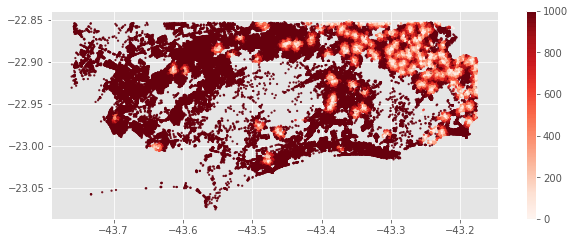

In [115]:
# distance to the nearest amenity of any type
n = 1
fig, ax = network.plot(all_access[n], bbox=bbox, plot_kwargs=plot_kwargs, fig_kwargs=fig_kwargs, cbar_kwargs=cbar_kwargs) #bmap_kwargs=bmap_kwargs
ax.set_facecolor(bgcolor)
ax.set_title('Distância a pé (m) da comodidade mais próxima no rio', fontsize=15)
fig.savefig('../data/accessibility-Rio.png', dpi=200, bbox_inches='tight')

Como visto acima, existem algumas zonas onde as pessoas têm que caminhar mais de 500 metros para chegar à comodidade mais próxima, enquanto no centro histórico de Edimburgo há distâncias de caminhada de menos de 100 metros em média.

O mapa mostra a distância a pé em metros de cada nó da rede até o restaurante, bar, ... mais próximo. Porém, um melhor indicador de acessibilidade pode ser o acesso a um grande número de comodidades. Portanto, em vez do mais próximo, traçamos a acessibilidade para a quinta comodidade mais próxima:

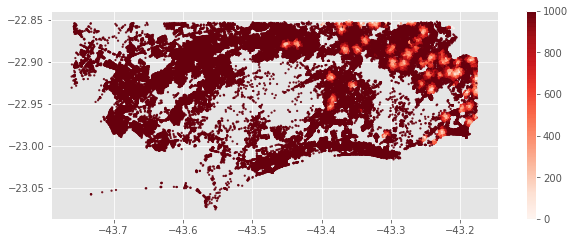

In [117]:
# distance to the 5th nearest amenity of any type
n = 5
fig, ax = network.plot(all_access[n], bbox=bbox, plot_kwargs=plot_kwargs, fig_kwargs=fig_kwargs, cbar_kwargs=cbar_kwargs) 
                             #bmap_kwargs=bmap_kwargs)
ax.set_facecolor(bgcolor)
ax.set_title('Distância a pé (m) até a 5ª comodidade mais próxima no Rio', fontsize=15)
fig.savefig('../data/accessibility-nearest5th-Rio.png', dpi=200, bbox_inches='tight')

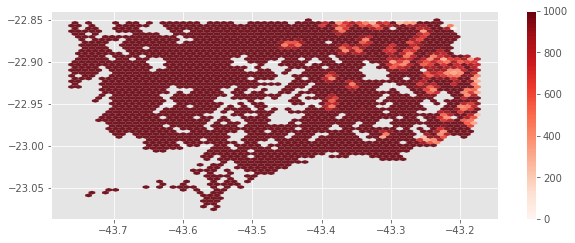

In [118]:
# distance to the 5th nearest amenity of any type, as hexbins
n=5
fig, ax = network.plot(all_access[n], bbox=bbox, plot_type='hexbin', plot_kwargs=hex_plot_kwargs, #, bmap_kwargs=bmap_kwargs
                             fig_kwargs=fig_kwargs, cbar_kwargs=cbar_kwargs)
ax.set_facecolor(bgcolor)
ax.set_title('Distância a pé (m) da comodidade mais próxima no Rio', fontsize=15)
fig.savefig('../data/accessibility-hexbins-Rio.png', dpi=200, bbox_inches='tight')

Pontuações de acessibilidade podem ser construídas rapidamente para responder a uma determinada pergunta: se é o acesso a serviços essenciais ou bairros onde se pode caminhar que atraem jovens trabalhadores. Para nossos propósitos, o acesso a restaurantes, lojas, cafés, bares e pubs é considerado essencial para os usuários do Airbnb. Portanto, estamos ponderando todas as comodidades igualmente e usando a distância até a quinta comodidade mais próxima como uma medida composta de acessibilidade. Isso dá uma imagem mais clara de quais bairros são mais fáceis de percorrer, em comparação com a plotagem apenas da distância até o local / comodidade mais próximo.

#### Setting distance to the fifth nearest amenity as a compound measure of accessibility

In [119]:
# retreive the 5th nearest amenities (of all types) to each node in the network
num_pois = 5
N_nearest_access = network.nearest_pois(distance=distance, category='all', num_pois=num_pois)

# returned a df with the number of columns equal to the number of POIs that are requested
# each cell represents the network distance from the node to each of the 5 POIs
print('{:,} nodes'.format(len(N_nearest_access)))

Access_Score = pd.DataFrame(N_nearest_access[5])
Access_Score.head()

75,550 nodes


,5
id,
25038483,1000.0
25038484,1000.0
25038485,1000.0
25038487,1000.0
25038488,1000.0


#### Network aggregation

Aqui, combinamos `Score`, nossa medida composta de acessibilidade (distância da rede do nó ao 5º POIs mais próximos) com o conjunto de dados de POIs` df_pois`.

In [120]:
# We name our measure 'Score'
Access = Access_Score.rename(columns={5:'Score'})
Access.head()
Access.dtypes

Score    float64
dtype: object

Obtenha o `node_id` mais próximo para cada POI, com base em seu lat-lon

In [121]:
df_pois['node_ids'] = network.get_node_ids(df_pois['Venue Longitude'], df_pois['Venue Latitude'])
df_pois.head()

,Neighbourhood,Neighbourhood Latitude,Neighbourhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,node_ids
5,Paquetá,-22.764232,-43.111233,Quintal da Regina,-22.760820,-43.108288,Bar,1065032425
6,Paquetá,-22.764232,-43.111233,Tia Leleta Bar,-22.760765,-43.108334,Restaurant,1065032425
8,Paquetá,-22.764232,-43.111233,Zeca's Restaurante,-22.761253,-43.107708,Restaurant,1065032425
22,Bancários,-22.792451,-43.180994,Bar Água Viva,-22.795046,-43.180115,Burger Joint,1065032430
24,Bancários,-22.792451,-43.180994,Rei do Bolinho de Bacalhau,-22.795611,-43.183378,Restaurant,1065032430


In [122]:
#pois_sub.reset_index(level=0, inplace=True) # convert index into column
Access.reset_index(level=0, inplace=True)

In [123]:
# Set both columns to have the same names
Access = Access.rename(columns={'id':'node_ids'})
Access.head()

,node_ids,Score
0,25038483,1000.0
1,25038484,1000.0
2,25038485,1000.0
3,25038487,1000.0
4,25038488,1000.0


In [124]:
# Merging by node_ids
merged = pd.merge(df_pois, Access, on='node_ids')

In [125]:
# Checking column types make sense
merged.dtypes

Neighbourhood               object
Neighbourhood Latitude     float64
Neighbourhood Longitude    float64
Venue                       object
Venue Latitude             float64
Venue Longitude            float64
Venue Category              object
node_ids                     int64
Score                      float64
dtype: object

In [126]:
merged.head()

,Neighbourhood,Neighbourhood Latitude,Neighbourhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,node_ids,Score
0,Paquetá,-22.764232,-43.111233,Quintal da Regina,-22.760820,-43.108288,Bar,1065032425,0.0
1,Paquetá,-22.764232,-43.111233,Tia Leleta Bar,-22.760765,-43.108334,Restaurant,1065032425,0.0
2,Paquetá,-22.764232,-43.111233,Zeca's Restaurante,-22.761253,-43.107708,Restaurant,1065032425,0.0
3,Pitangueiras,-22.816954,-43.179992,Mouras Bar,-22.819222,-43.177830,Bakery,1065032425,0.0
4,Zumbi,-22.821116,-43.176014,Biroska do Camarão,-22.823427,-43.178457,Bar,1065032425,0.0


<AxesSubplot:>

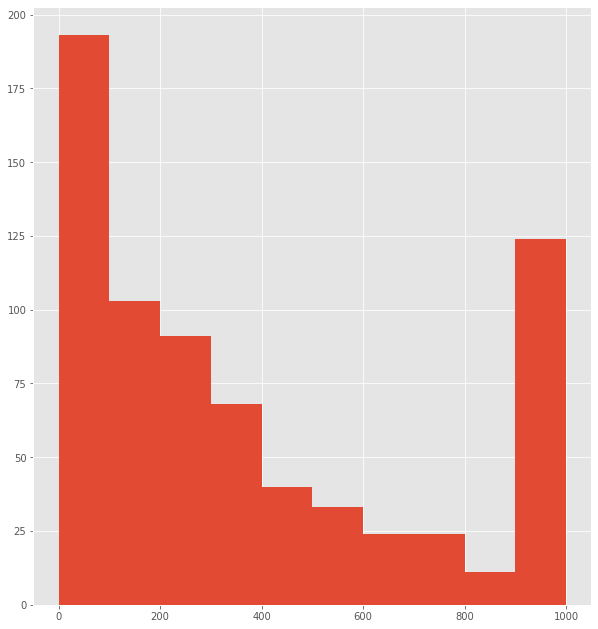

In [127]:
merged['Score'].hist(figsize=(10,11))

In [128]:
# Setting both columns have the same name for merging
df = df.rename(columns={'borough': 'Neighbourhood'})

In [129]:
# Merging by neighbourhoods
df_merged = pd.merge(merged, df, on='Neighbourhood')

In [130]:
# Save cleaned for modelling
df_merged.to_csv(r'../data/listings_model.csv', index=id, header=True)